Null Values in each column:
 LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64

Total Null Values:  7829

Dropping features with more than 500 null values: ['Alley', 'MasVnrType', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']


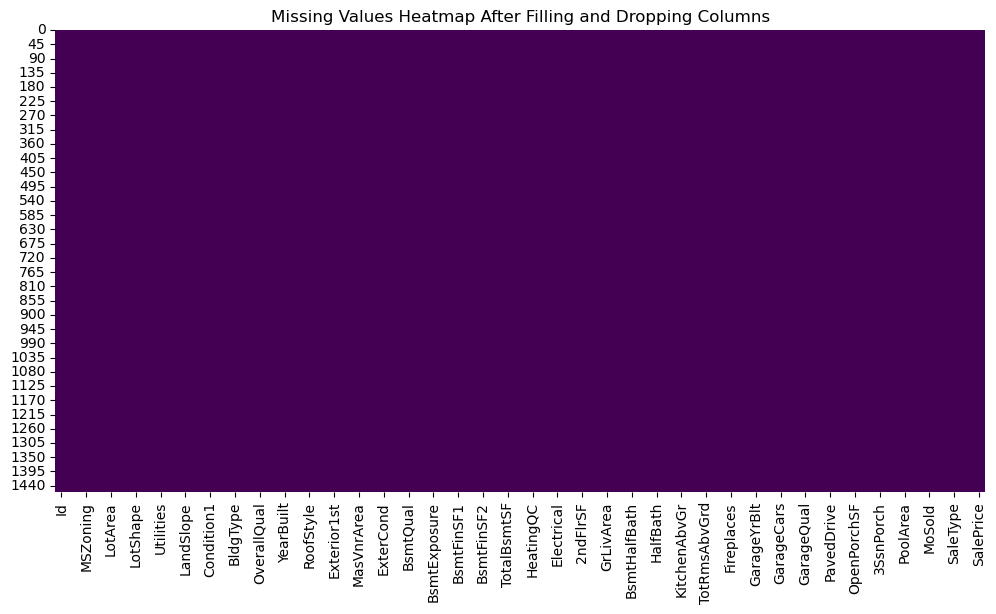

Data after one-hot encoding:
    Id  MSSubClass  LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt  \
0   1          60         65.0     8450            7            5       2003   
1   2          20         80.0     9600            6            8       1976   
2   3          60         68.0    11250            7            5       2001   
3   4          70         60.0     9550            7            5       1915   
4   5          60         84.0    14260            8            5       2000   

   YearRemodAdd  MasVnrArea  BsmtFinSF1  ...  SaleType_ConLI  SaleType_ConLw  \
0          2003       196.0         706  ...           False           False   
1          1976         0.0         978  ...           False           False   
2          2002       162.0         486  ...           False           False   
3          1970         0.0         216  ...           False           False   
4          2000       350.0         655  ...           False           False   

   SaleT

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import Ridge
from xgboost import XGBRegressor
import lightgbm as lgb
from catboost import CatBoostRegressor

# Step 1: Import the train.csv
train = pd.read_csv('train.csv')

# Step 2: Check for Null Values and analyze it
null_values = train.isnull().sum()
print("Null Values in each column:\n", null_values[null_values > 0])
print("\nTotal Null Values: ", null_values.sum())

# Separate numeric and categorical columns
numeric_cols = train.select_dtypes(include=['number']).columns
categorical_cols = train.select_dtypes(include=['object']).columns

# Fill missing values for numeric columns with the median
train[numeric_cols] = train[numeric_cols].fillna(train[numeric_cols].median())

# Fill missing values for categorical columns with the mode (most frequent value)
for col in categorical_cols:
    mode_val = train[col].mode()[0]  # Get the most frequent value
    train[col].fillna(mode_val, inplace=True)

# Drop features with more than 500 null values (this should now be zero since missing values are filled)
features_to_drop = null_values[null_values > 500].index
print(f"\nDropping features with more than 500 null values: {features_to_drop.tolist()}")
train.drop(columns=features_to_drop, inplace=True)

# Analyze the missing data after filling and dropping features (optional visualization)
plt.figure(figsize=(12, 6))
sns.heatmap(train.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values Heatmap After Filling and Dropping Columns')
plt.show()

# Step 3: One-hot encoding for each string-based feature
# Identify categorical variables
categorical_cols = train.select_dtypes(include=['object']).columns

# Apply one-hot encoding to categorical variables
train = pd.get_dummies(train, columns=categorical_cols, drop_first=True)

print("Data after one-hot encoding:\n", train.head())

# Step 4: Checking correlation
# Correlation matrix
corr_matrix = train.corr()

# Select features with correlation >= 0.2 with SalePrice
selected_features = corr_matrix.index[corr_matrix['SalePrice'].abs() >= 0.2].tolist()

# Remove SalePrice from the feature list since it's the target
selected_features.remove('SalePrice')

print(f"\nSelected features with correlation >= 0.2: {selected_features}")

# Step 5: Split the data into Train (70%), Validation (15%), and Test (15%)
# Separate target variable 'SalePrice' from the features
X = train[selected_features]
y = train['SalePrice']

# Split into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print(f"Training set: {X_train.shape}, Validation set: {X_val.shape}, Test set: {X_test.shape}")

# Step 6: Define base models and stacking model
estimators = [
    ('xgb', XGBRegressor(n_estimators=1000, learning_rate=0.05, max_depth=10, random_state=42)),
    ('lgbm', lgb.LGBMRegressor(n_estimators=1000, learning_rate=0.05, num_leaves=31, random_state=42)),
    ('catboost', CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=10, random_seed=42, verbose=0))
]

# Initialize the stacking model with Ridge as the final estimator
stacking_model = StackingRegressor(estimators=estimators, final_estimator=Ridge())

# Train the stacking model
stacking_model.fit(X_train, y_train)

# Step 7: Predict on the Validation set
y_val_pred = stacking_model.predict(X_val)

# Step 8: Calculate MSE and RMSE for the Validation set
# Calculate the logarithm of the predictions and the actual values
y_val_log_pred = np.log1p(y_val_pred)
y_val_log_actual = np.log1p(y_val)

# Calculate the Logarithmic MSE and RMSE
mse_log = mean_squared_error(y_val_log_actual, y_val_log_pred)
rmse_log = np.sqrt(mse_log)

print(f"\nValidation MSE (Logarithmic): {mse_log}")
print(f"Validation RMSE (Logarithmic): {rmse_log}")

Here's an enhanced version of your existing code with hyperparameter tuning and cross-validation:

Null Values in each column:
 LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64

Total Null Values:  7829

Dropping features with more than 500 null values: ['Alley', 'MasVnrType', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']


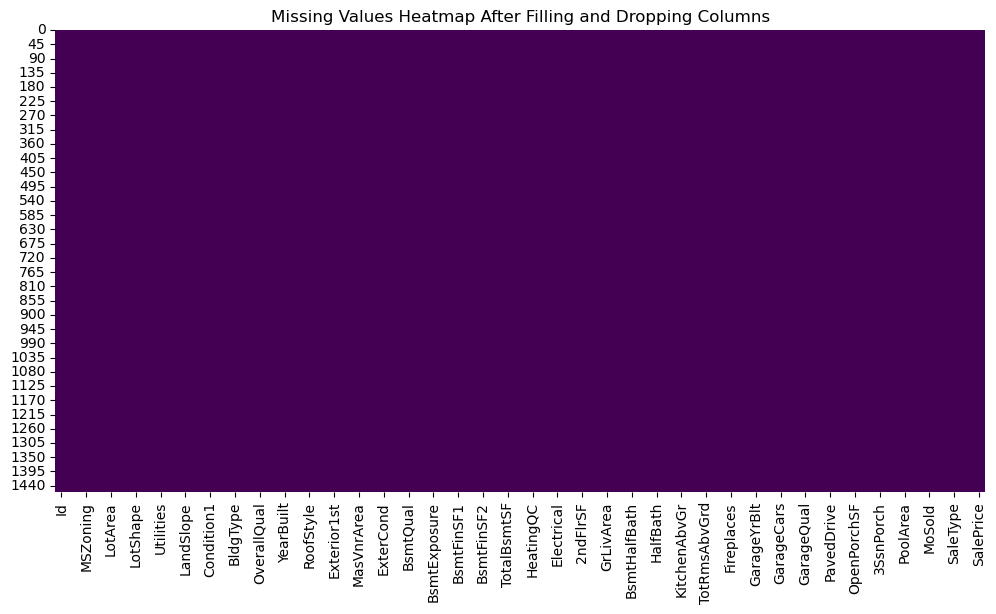

Data after one-hot encoding:
    Id  MSSubClass  LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt  \
0   1          60         65.0     8450            7            5       2003   
1   2          20         80.0     9600            6            8       1976   
2   3          60         68.0    11250            7            5       2001   
3   4          70         60.0     9550            7            5       1915   
4   5          60         84.0    14260            8            5       2000   

   YearRemodAdd  MasVnrArea  BsmtFinSF1  ...  SaleType_ConLI  SaleType_ConLw  \
0          2003       196.0         706  ...           False           False   
1          1976         0.0         978  ...           False           False   
2          2002       162.0         486  ...           False           False   
3          1970         0.0         216  ...           False           False   
4          2000       350.0         655  ...           False           False   

   SaleT

c:\Users\utkar\.conda\envs\py310\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\utkar\.conda\envs\py310\lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000488 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2197
[LightGBM] [Info] Number of data points in the train set: 681, number of used features: 53
[LightGBM] [Info] Start training from score 179314.759178
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import Ridge
from xgboost import XGBRegressor
import lightgbm as lgb
from catboost import CatBoostRegressor

# Step 1: Import the train.csv
train = pd.read_csv('train.csv')

# Step 2: Check for Null Values and analyze it
null_values = train.isnull().sum()
print("Null Values in each column:\n", null_values[null_values > 0])
print("\nTotal Null Values: ", null_values.sum())

# Separate numeric and categorical columns
numeric_cols = train.select_dtypes(include=['number']).columns
categorical_cols = train.select_dtypes(include=['object']).columns

# Fill missing values for numeric columns with the median
train[numeric_cols] = train[numeric_cols].fillna(train[numeric_cols].median())

# Fill missing values for categorical columns with the mode (most frequent value)
for col in categorical_cols:
    mode_val = train[col].mode()[0]  # Get the most frequent value
    train[col].fillna(mode_val, inplace=True)

# Drop features with more than 500 null values (this should now be zero since missing values are filled)
features_to_drop = null_values[null_values > 500].index
print(f"\nDropping features with more than 500 null values: {features_to_drop.tolist()}")
train.drop(columns=features_to_drop, inplace=True)

# Analyze the missing data after filling and dropping features (optional visualization)
plt.figure(figsize=(12, 6))
sns.heatmap(train.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values Heatmap After Filling and Dropping Columns')
plt.show()

# Step 3: One-hot encoding for each string-based feature
# Identify categorical variables
categorical_cols = train.select_dtypes(include=['object']).columns

# Apply one-hot encoding to categorical variables
train = pd.get_dummies(train, columns=categorical_cols, drop_first=True)

print("Data after one-hot encoding:\n", train.head())

# Step 4: Checking correlation
# Correlation matrix
corr_matrix = train.corr()

# Select features with correlation >= 0.2 with SalePrice
selected_features = corr_matrix.index[corr_matrix['SalePrice'].abs() >= 0.2].tolist()

# Remove SalePrice from the feature list since it's the target
selected_features.remove('SalePrice')

print(f"\nSelected features with correlation >= 0.2: {selected_features}")

# Step 5: Split the data into Train (70%), Validation (15%), and Test (15%)
# Separate target variable 'SalePrice' from the features
X = train[selected_features]
y = train['SalePrice']

# Split into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print(f"Training set: {X_train.shape}, Validation set: {X_val.shape}, Test set: {X_test.shape}")

# Step 6: Define base models and stacking model
estimators = [
    ('xgb', XGBRegressor(n_estimators=1000, learning_rate=0.05, max_depth=10, random_state=42)),
    ('lgbm', lgb.LGBMRegressor(n_estimators=1000, learning_rate=0.05, num_leaves=31, random_state=42)),
    ('catboost', CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=10, random_seed=42, verbose=0))
]

# Initialize the stacking model with Ridge as the final estimator
stacking_model = StackingRegressor(estimators=estimators, final_estimator=Ridge())

# Hyperparameter tuning for stacking model
param_grid = {
    'xgb__n_estimators': [500, 1000],
    'xgb__learning_rate': [0.01, 0.05, 0.1],
    'xgb__max_depth': [5, 10, 15],
    'lgbm__n_estimators': [500, 1000],
    'lgbm__learning_rate': [0.01, 0.05, 0.1],
    'lgbm__num_leaves': [31, 50],
    'catboost__iterations': [500, 1000],
    'catboost__learning_rate': [0.05, 0.1],
    'catboost__depth': [6, 10]
}

grid_search = GridSearchCV(estimator=stacking_model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

# Best parameters and model
print(f"Best Parameters: {grid_search.best_params_}")
stacking_model = grid_search.best_estimator_

# Step 7: Predict on the Validation set
y_val_pred = stacking_model.predict(X_val)

# Step 8: Calculate MSE and RMSE for the Validation set
# Calculate the logarithm of the predictions and the actual values
y_val_log_pred = np.log1p(y_val_pred)
y_val_log_actual = np.log1p(y_val)

# Calculate the Logarithmic MSE and RMSE
mse_log = mean_squared_error(y_val_log_actual, y_val_log_pred)
rmse_log = np.sqrt(mse_log)

print(f"\nValidation MSE (Logarithmic): {mse_log}")
print(f"Validation RMSE (Logarithmic): {rmse_log}")

# Cross-validation score
cv_scores = cross_val_score(stacking_model, X, y, cv=5, scoring='neg_mean_squared_error')
print(f"Cross-validated RMSE: {np.sqrt(-cv_scores.mean())}")

Null Values in each column:
 LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64

Total Null Values:  7829

Dropping features with more than 500 null values: ['Alley', 'MasVnrType', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']


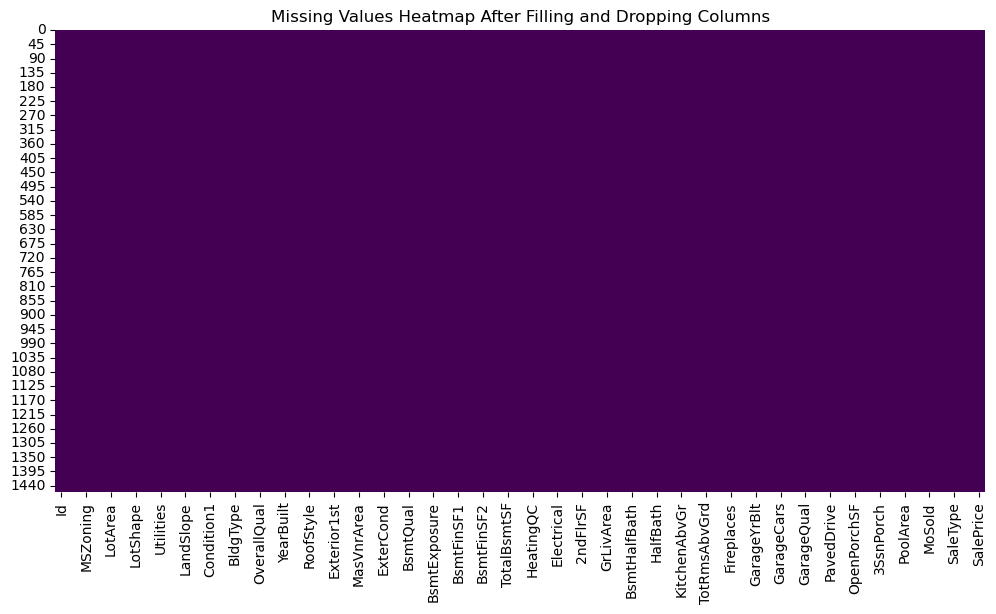

Data after one-hot encoding:
    Id  MSSubClass  LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt  \
0   1          60         65.0     8450            7            5       2003   
1   2          20         80.0     9600            6            8       1976   
2   3          60         68.0    11250            7            5       2001   
3   4          70         60.0     9550            7            5       1915   
4   5          60         84.0    14260            8            5       2000   

   YearRemodAdd  MasVnrArea  BsmtFinSF1  ...  SaleType_ConLI  SaleType_ConLw  \
0          2003       196.0         706  ...           False           False   
1          1976         0.0         978  ...           False           False   
2          2002       162.0         486  ...           False           False   
3          1970         0.0         216  ...           False           False   
4          2000       350.0         655  ...           False           False   

   SaleT

c:\Users\utkar\.conda\envs\py310\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\utkar\.conda\envs\py310\lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000246 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1724
[LightGBM] [Info] Number of data points in the train set: 681, number of used features: 36
[LightGBM] [Info] Start training from score 179314.759178
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import Ridge
from xgboost import XGBRegressor
import lightgbm as lgb
from catboost import CatBoostRegressor

# Step 1: Import the train.csv
train = pd.read_csv('train.csv')

# Step 2: Check for Null Values and analyze it
null_values = train.isnull().sum()
print("Null Values in each column:\n", null_values[null_values > 0])
print("\nTotal Null Values: ", null_values.sum())

# Separate numeric and categorical columns
numeric_cols = train.select_dtypes(include=['number']).columns
categorical_cols = train.select_dtypes(include=['object']).columns

# Fill missing values for numeric columns with the median
train[numeric_cols] = train[numeric_cols].fillna(train[numeric_cols].median())

# Fill missing values for categorical columns with the mode (most frequent value)
for col in categorical_cols:
    mode_val = train[col].mode()[0]  # Get the most frequent value
    train[col].fillna(mode_val, inplace=True)

# Drop features with more than 500 null values (this should now be zero since missing values are filled)
features_to_drop = null_values[null_values > 500].index
print(f"\nDropping features with more than 500 null values: {features_to_drop.tolist()}")
train.drop(columns=features_to_drop, inplace=True)

# Analyze the missing data after filling and dropping features (optional visualization)
plt.figure(figsize=(12, 6))
sns.heatmap(train.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values Heatmap After Filling and Dropping Columns')
plt.show()

# Step 3: One-hot encoding for each string-based feature
# Identify categorical variables
categorical_cols = train.select_dtypes(include=['object']).columns

# Apply one-hot encoding to categorical variables
train = pd.get_dummies(train, columns=categorical_cols, drop_first=True)

print("Data after one-hot encoding:\n", train.head())

# Step 4: Checking correlation
# Correlation matrix
corr_matrix = train.corr()

# Select features with correlation >= 0.2 with SalePrice
selected_features = corr_matrix.index[corr_matrix['SalePrice'].abs() >= 0.3].tolist()

# Remove SalePrice from the feature list since it's the target
selected_features.remove('SalePrice')

print(f"\nSelected features with correlation >= 0.3: {selected_features}")

# Step 5: Split the data into Train (70%), Validation (15%), and Test (15%)
# Separate target variable 'SalePrice' from the features
X = train[selected_features]
y = train['SalePrice']

# Split into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print(f"Training set: {X_train.shape}, Validation set: {X_val.shape}, Test set: {X_test.shape}")

# Step 6: Define base models and stacking model
estimators = [
    ('xgb', XGBRegressor(n_estimators=500, learning_rate=0.05, max_depth=10, random_state=42)),
    ('lgbm', lgb.LGBMRegressor(n_estimators=500, learning_rate=0.05, num_leaves=31, random_state=42)),
    ('catboost', CatBoostRegressor(iterations=500, learning_rate=0.05, depth=6, random_seed=42, verbose=0))
]

# Initialize the stacking model with Ridge as the final estimator
stacking_model = StackingRegressor(estimators=estimators, final_estimator=Ridge())

# Hyperparameter tuning for stacking model using RandomizedSearchCV
param_grid = {
    'xgb__n_estimators': [250, 500],
    'xgb__learning_rate': [0.05, 0.1],
    'xgb__max_depth': [5, 10],
    'lgbm__n_estimators': [250, 500],
    'lgbm__learning_rate': [0.05, 0.1],
    'lgbm__num_leaves': [31, 50],
    'catboost__iterations': [250, 500],
    'catboost__learning_rate': [0.05, 0.1],
    'catboost__depth': [4, 6]
}

random_search = RandomizedSearchCV(estimator=stacking_model, param_distributions=param_grid, 
                                   n_iter=10, cv=3, scoring='neg_mean_squared_error', random_state=42)
random_search.fit(X_train, y_train)

# Best parameters and model
print(f"Best Parameters: {random_search.best_params_}")
stacking_model = random_search.best_estimator_

# Step 7: Predict on the Validation set
y_val_pred = stacking_model.predict(X_val)

# Step 8: Calculate MSE and RMSE for the Validation set
# Calculate the logarithm of the predictions and the actual values
y_val_log_pred = np.log1p(y_val_pred)
y_val_log_actual = np.log1p(y_val)

# Calculate the Logarithmic MSE and RMSE
mse_log = mean_squared_error(y_val_log_actual, y_val_log_pred)
rmse_log = np.sqrt(mse_log)

print(f"\nValidation MSE (Logarithmic): {mse_log}")
print(f"Validation RMSE (Logarithmic): {rmse_log}")

# Cross-validation score
cv_scores = cross_val_score(stacking_model, X, y, cv=5, scoring='neg_mean_squared_error')
print(f"Cross-validated RMSE: {np.sqrt(-cv_scores.mean())}")

Null Values in each column:
 LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64

Total Null Values:  7829

Dropping features with more than 500 null values: ['Alley', 'MasVnrType', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']


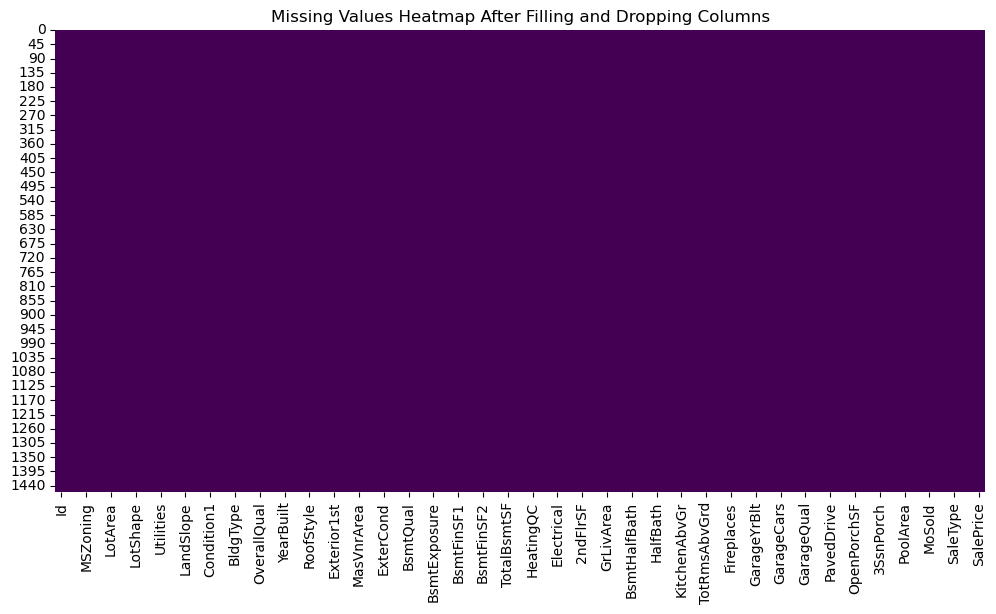

Data after one-hot encoding:
    Id  MSSubClass  LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt  \
0   1          60         65.0     8450            7            5       2003   
1   2          20         80.0     9600            6            8       1976   
2   3          60         68.0    11250            7            5       2001   
3   4          70         60.0     9550            7            5       1915   
4   5          60         84.0    14260            8            5       2000   

   YearRemodAdd  MasVnrArea  BsmtFinSF1  ...  SaleType_ConLI  SaleType_ConLw  \
0          2003       196.0         706  ...           False           False   
1          1976         0.0         978  ...           False           False   
2          2002       162.0         486  ...           False           False   
3          1970         0.0         216  ...           False           False   
4          2000       350.0         655  ...           False           False   

   SaleT

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
from xgboost import XGBRegressor

# Step 1: Import the train.csv
train = pd.read_csv('train.csv')

# Step 2: Check for Null Values and analyze it
null_values = train.isnull().sum()
print("Null Values in each column:\n", null_values[null_values > 0])
print("\nTotal Null Values: ", null_values.sum())

# Separate numeric and categorical columns
numeric_cols = train.select_dtypes(include=['number']).columns
categorical_cols = train.select_dtypes(include=['object']).columns

# Fill missing values for numeric columns with the median
train[numeric_cols] = train[numeric_cols].fillna(train[numeric_cols].median())

# Fill missing values for categorical columns with the mode (most frequent value)
for col in categorical_cols:
    mode_val = train[col].mode()[0]  # Get the most frequent value
    train[col].fillna(mode_val, inplace=True)

# Drop features with more than 500 null values (this should now be zero since missing values are filled)
features_to_drop = null_values[null_values > 500].index
print(f"\nDropping features with more than 500 null values: {features_to_drop.tolist()}")
train.drop(columns=features_to_drop, inplace=True)

# Analyze the missing data after filling and dropping features (optional visualization)
plt.figure(figsize=(12, 6))
sns.heatmap(train.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values Heatmap After Filling and Dropping Columns')
plt.show()

# Step 3: One-hot encoding for each string-based feature
# Identify categorical variables
categorical_cols = train.select_dtypes(include=['object']).columns

# Apply one-hot encoding to categorical variables
train = pd.get_dummies(train, columns=categorical_cols, drop_first=True)

print("Data after one-hot encoding:\n", train.head())

# Step 4: Checking correlation
# Correlation matrix
corr_matrix = train.corr()

# Select features with correlation >= 0.2 with SalePrice
selected_features = corr_matrix.index[corr_matrix['SalePrice'].abs() >= 0.2].tolist()

# Remove SalePrice from the feature list since it's the target
selected_features.remove('SalePrice')

print(f"\nSelected features with correlation >= 0.2: {selected_features}")

# Step 5: Split the data into Train (70%), Validation (15%), and Test (15%)
# Separate target variable 'SalePrice' from the features
X = train[selected_features]
y = train['SalePrice']

# Split into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print(f"Training set: {X_train.shape}, Validation set: {X_val.shape}, Test set: {X_test.shape}")

# Step 6: Define and train the XGBoost model using GridSearchCV
xgb_model = XGBRegressor(random_state=42)

# Hyperparameter tuning for XGBoost
param_grid = {
    'n_estimators': [500, 1000],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [5, 10, 15]
}

grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

# Best parameters and model
print(f"Best Parameters: {grid_search.best_params_}")
xgb_model = grid_search.best_estimator_

# Step 7: Predict on the Validation set
y_val_pred = xgb_model.predict(X_val)

# Step 8: Calculate Logarithmic RMSE and R² for the Validation set
# Calculate the logarithm of the predictions and the actual values
y_val_log_pred = np.log1p(y_val_pred)
y_val_log_actual = np.log1p(y_val)

# Calculate the Logarithmic RMSE
mse_log = mean_squared_error(y_val_log_actual, y_val_log_pred)
rmse_log = np.sqrt(mse_log)

# Calculate the R² value
r2 = r2_score(y_val, y_val_pred)

print(f"\nValidation RMSE (Logarithmic): {rmse_log}")
print(f"Validation R²: {r2}")

# Cross-validation score
cv_scores = cross_val_score(xgb_model, X, y, cv=5, scoring='r2')
print(f"Cross-validated R²: {cv_scores.mean()}")

Here's the updated code using Recursive Feature Elimination (RFE) to potentially improve the model's performance:

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.feature_selection import RFE
from xgboost import XGBRegressor

# Step 1: Import the train.csv
train = pd.read_csv('train.csv')

# Step 2: Check for Null Values and analyze it
null_values = train.isnull().sum()
print("Null Values in each column:\n", null_values[null_values > 0])
print("\nTotal Null Values: ", null_values.sum())

# Separate numeric and categorical columns
numeric_cols = train.select_dtypes(include=['number']).columns
categorical_cols = train.select_dtypes(include=['object']).columns

# Fill missing values for numeric columns with the median
train[numeric_cols] = train[numeric_cols].fillna(train[numeric_cols].median())

# Fill missing values for categorical columns with the mode (most frequent value)
for col in categorical_cols:
    mode_val = train[col].mode()[0]  # Get the most frequent value
    train[col].fillna(mode_val, inplace=True)

# Drop features with more than 500 null values (this should now be zero since missing values are filled)
features_to_drop = null_values[null_values > 500].index
print(f"\nDropping features with more than 500 null values: {features_to_drop.tolist()}")
train.drop(columns=features_to_drop, inplace=True)

# Step 3: One-hot encoding for each string-based feature
# Identify categorical variables
categorical_cols = train.select_dtypes(include=['object']).columns

# Apply one-hot encoding to categorical variables
train = pd.get_dummies(train, columns=categorical_cols, drop_first=True)

print("Data after one-hot encoding:\n", train.head())

# Step 4: Checking correlation
# Correlation matrix
corr_matrix = train.corr()

# Select features with correlation >= 0.2 with SalePrice
selected_features = corr_matrix.index[corr_matrix['SalePrice'].abs() >= 0.2].tolist()

# Remove SalePrice from the feature list since it's the target
selected_features.remove('SalePrice')

print(f"\nSelected features with correlation >= 0.2: {selected_features}")

# Step 5: Split the data into Train (70%), Validation (15%), and Test (15%)
# Separate target variable 'SalePrice' from the features
X = train[selected_features]
y = train['SalePrice']

# Step 6: Apply Recursive Feature Elimination (RFE) with XGBoost
model = XGBRegressor(random_state=42)
rfe = RFE(estimator=model, n_features_to_select=20, step=1)
X_rfe = rfe.fit_transform(X, y)

print(f"Selected features by RFE: {X.columns[rfe.support_].tolist()}")

# Split into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X_rfe, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print(f"Training set: {X_train.shape}, Validation set: {X_val.shape}, Test set: {X_test.shape}")

# Step 7: Use GridSearchCV to tune XGBoost hyperparameters
param_grid = {
    'n_estimators': [500, 1000],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [5, 10, 15],
    'subsample': [0.8, 1],
    'colsample_bytree': [0.8, 1]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

# Best parameters and model
print(f"Best Parameters: {grid_search.best_params_}")
best_model = grid_search.best_estimator_

# Step 8: Predict on the Validation set
y_val_pred = best_model.predict(X_val)

# Step 9: Calculate RMSE and R² for the Validation set
# Calculate the logarithm of the predictions and the actual values
y_val_log_pred = np.log1p(y_val_pred)
y_val_log_actual = np.log1p(y_val)

# Calculate the Logarithmic RMSE
mse_log = mean_squared_error(y_val_log_actual, y_val_log_pred)
rmse_log = np.sqrt(mse_log)

# Calculate R²
r2 = r2_score(y_val, y_val_pred)

print(f"\nValidation RMSE (Logarithmic): {rmse_log}")
print(f"Validation R²: {r2}")

# Cross-validation score
cv_scores = cross_val_score(best_model, X_rfe, y, cv=5, scoring='r2')
print(f"Cross-validated R²: {cv_scores.mean()}")

Null Values in each column:
 LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64

Total Null Values:  7829

Dropping features with more than 500 null values: ['Alley', 'MasVnrType', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']
Data after one-hot encoding:
    Id  MSSubClass  LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt  \
0   1          60         65.0     8450            7            5       2003   
1   2          20         80.0     9600            6            8       1976   
2   3          60         68.0    11250            7            5       2001   
3   4          70         60.0     9550            7       

Here’s the full code using a stacking ensemble of XGBoost, LightGBM, and CatBoost models, with Recursive Feature Elimination (RFE) for feature selection:

Null Values in each column:
 LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64

Total Null Values:  7829

Dropping features with more than 500 null values: ['Alley', 'MasVnrType', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']


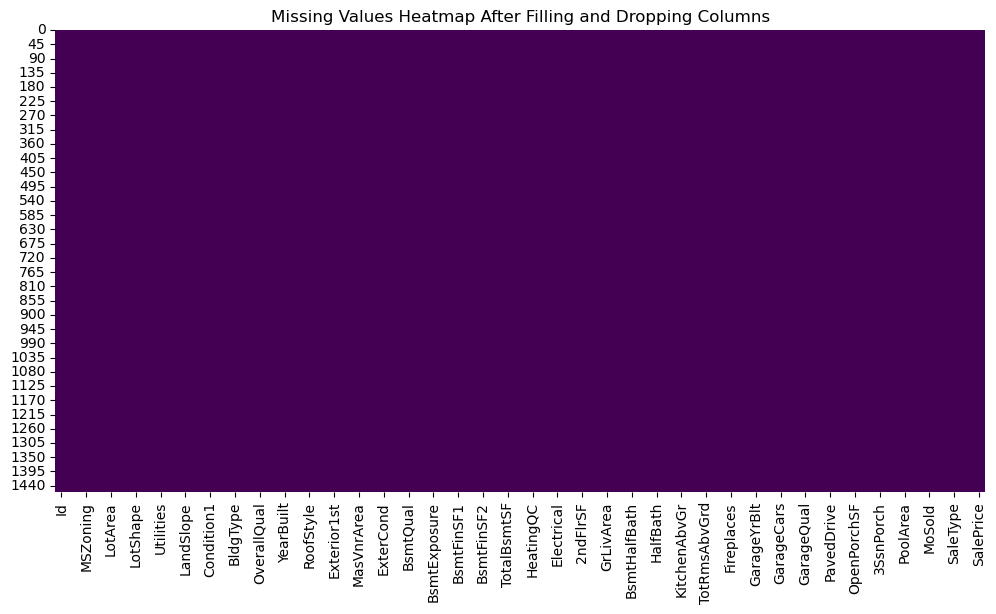

Data after one-hot encoding:
    Id  MSSubClass  LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt  \
0   1          60         65.0     8450            7            5       2003   
1   2          20         80.0     9600            6            8       1976   
2   3          60         68.0    11250            7            5       2001   
3   4          70         60.0     9550            7            5       1915   
4   5          60         84.0    14260            8            5       2000   

   YearRemodAdd  MasVnrArea  BsmtFinSF1  ...  SaleType_ConLI  SaleType_ConLw  \
0          2003       196.0         706  ...           False           False   
1          1976         0.0         978  ...           False           False   
2          2002       162.0         486  ...           False           False   
3          1970         0.0         216  ...           False           False   
4          2000       350.0         655  ...           False           False   

   SaleT

c:\Users\utkar\.conda\envs\py310\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\utkar\.conda\envs\py310\lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000336 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1184
[LightGBM] [Info] Number of data points in the train set: 681, number of used features: 20
[LightGBM] [Info] Start training from score 179314.759178
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

KeyboardInterrupt: 

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import Ridge
from sklearn.feature_selection import RFE
from xgboost import XGBRegressor
import lightgbm as lgb
from catboost import CatBoostRegressor

# Step 1: Import the train.csv
train = pd.read_csv('train.csv')

# Step 2: Check for Null Values and analyze it
null_values = train.isnull().sum()
print("Null Values in each column:\n", null_values[null_values > 0])
print("\nTotal Null Values: ", null_values.sum())

# Separate numeric and categorical columns
numeric_cols = train.select_dtypes(include=['number']).columns
categorical_cols = train.select_dtypes(include=['object']).columns

# Fill missing values for numeric columns with the median
train[numeric_cols] = train[numeric_cols].fillna(train[numeric_cols].median())

# Fill missing values for categorical columns with the mode (most frequent value)
for col in categorical_cols:
    mode_val = train[col].mode()[0]
    train[col].fillna(mode_val, inplace=True)

# Drop features with more than 500 null values
features_to_drop = null_values[null_values > 500].index
print(f"\nDropping features with more than 500 null values: {features_to_drop.tolist()}")
train.drop(columns=features_to_drop, inplace=True)

# Analyze the missing data after filling and dropping features
plt.figure(figsize=(12, 6))
sns.heatmap(train.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values Heatmap After Filling and Dropping Columns')
plt.show()

# Step 3: One-hot encoding for each string-based feature
categorical_cols = train.select_dtypes(include=['object']).columns
train = pd.get_dummies(train, columns=categorical_cols, drop_first=True)

print("Data after one-hot encoding:\n", train.head())

# Step 4: Checking correlation
corr_matrix = train.corr()

# Select features with correlation >= 0.2 with SalePrice
selected_features = corr_matrix.index[corr_matrix['SalePrice'].abs() >= 0.2].tolist()
selected_features.remove('SalePrice')

print(f"\nSelected features with correlation >= 0.2: {selected_features}")

# Step 5: Split the data into Train (70%), Validation (15%), and Test (15%)
X = train[selected_features]
y = train['SalePrice']

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print(f"Training set: {X_train.shape}, Validation set: {X_val.shape}, Test set: {X_test.shape}")

# Step 6: Define base models and stacking model
estimators = [
    ('xgb', XGBRegressor(n_estimators=1000, learning_rate=0.05, max_depth=10, random_state=42)),
    ('lgbm', lgb.LGBMRegressor(n_estimators=1000, learning_rate=0.05, num_leaves=31, random_state=42)),
    ('catboost', CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=10, random_seed=42, verbose=0))
]

# Initialize the stacking model with Ridge as the final estimator
stacking_model = StackingRegressor(estimators=estimators, final_estimator=Ridge())

# Apply Recursive Feature Elimination (RFE)
rfe = RFE(estimator=XGBRegressor(n_estimators=100, random_state=42), n_features_to_select=20)
X_train_rfe = rfe.fit_transform(X_train, y_train)
X_val_rfe = rfe.transform(X_val)
X_test_rfe = rfe.transform(X_test)

# Step 7: Train the stacking model with GridSearchCV
param_grid = {
    'xgb__n_estimators': [500, 1000],
    'xgb__learning_rate': [0.01, 0.05, 0.1],
    'xgb__max_depth': [5, 10, 15],
    'lgbm__n_estimators': [500, 1000],
    'lgbm__learning_rate': [0.01, 0.05, 0.1],
    'lgbm__num_leaves': [31, 50],
    'catboost__iterations': [500, 1000],
    'catboost__learning_rate': [0.05, 0.1],
    'catboost__depth': [6, 10]
}

grid_search = GridSearchCV(estimator=stacking_model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
grid_search.fit(X_train_rfe, y_train)

print(f"Best Parameters: {grid_search.best_params_}")
stacking_model = grid_search.best_estimator_

# Step 8: Predict on the Validation set
y_val_pred = stacking_model.predict(X_val_rfe)

# Step 9: Calculate RMSE (Logarithmic) and R²
y_val_log_pred = np.log1p(y_val_pred)
y_val_log_actual = np.log1p(y_val)

rmse_log = np.sqrt(mean_squared_error(y_val_log_actual, y_val_log_pred))
r2 = r2_score(y_val, y_val_pred)

print(f"\nValidation RMSE (Logarithmic): {rmse_log}")
print(f"Validation R²: {r2}")

# Step 10: Cross-validation score
cv_scores = cross_val_score(stacking_model, X_train_rfe, y_train, cv=5, scoring='r2')
print(f"Cross-validated R²: {cv_scores.mean()}")

SOME ERROR IMPROVEMENT